# Constants and useful functions

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import math
import numpy as np
import xlsxwriter
from openpyxl import load_workbook

from ipynb.fs.full.UtilCollections import PARAMS, POSITIONS, SEASONS, TEAMS
from ipynb.fs.full.UtilFunctions import format_season

In [23]:
pylab.rcParams.update(PARAMS)

In [24]:
def get_avg_by_position_each_season(stat):
    avg_by_pos_each_season = {}

    for position in POSITIONS:
        avg_by_pos_each_season[position] = []

    for season in avg_by_pos:    
        for position in season.index:
            if position in POSITIONS:
                avg_by_pos_each_season[position].append(season.loc[position][stat]) 
            
    return avg_by_pos_each_season


In [25]:
def get_sd_by_position_each_season(stat):
    sd_by_pos_each_season = {}

    for position in POSITIONS:
        sd_by_pos_each_season[position] = []

    for season in sd_by_pos:    
        for position in season.index:
            if position in POSITIONS:
                sd_by_pos_each_season[position].append(season.loc[position][stat]) 
            
    return sd_by_pos_each_season


In [26]:
def plot_position_graph(positions_dict, graph_title, playoffs=False):
    
    plt.figure(figsize=(12, 8), dpi=80)
    plt.grid()
    for position in POSITIONS:
        plt.plot(SEASONS[:], positions_dict[position], label=position, lw=3, marker='o', ms=10)

    if not playoffs: 
        plt.title(f"Average {graph_title} by position per season")
    else:
        plt.title(f"Average {graph_title} by position per playoffs")
    plt.xticks([2000,2003,2006,2009,2012,2015,2018,2021])
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5, prop={'size': 20})
    
    if '/' in graph_title:
        graph_title = graph_title.replace('/', '_')

    if not playoffs:
        plt.savefig(f"Results/PositionsEvolution/{graph_title}_by_pos_each_season.png")
    else:
        plt.savefig(f"Results/PositionsEvolution_Playoffs/{graph_title}_by_pos_each_playoffs.png")
    plt.show()

In [27]:
def plot_sd_position_graph(positions_dict, graph_title, playoffs=False):
    
    plt.figure(figsize=(15, 10), dpi=80)
    plt.grid()
    for position in POSITIONS:
        plt.plot(SEASONS[:], positions_dict[position], label=position, lw=3, marker='o', ms=10)

    if not playoffs: 
        plt.title(f"Standard deviation {graph_title} by position per season")
    else:
        plt.title(f"Standard deviation {graph_title} by position per playoffs")
    plt.xticks(SEASONS[:])
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5)
    
    if '/' in graph_title:
        graph_title = graph_title.replace('/', '_')

    if not playoffs:
        plt.savefig(f"Results/PositionsEvolution/sd_{graph_title}_by_pos_each_season.png")
    else:
        plt.savefig(f"Results/PositionsEvolution_Playoffs/sd_{graph_title}_by_pos_each_playoffs.png")
    plt.show()

In [28]:
def calculate_rank_corr_by_player_stat(df, eastern_standings, western_standings, stat, measure="mean"): #measure might be mean, sd or max
    if measure == "mean":
        grouped_df = pd.DataFrame(df.groupby(by=['Tm']).mean())
    elif measure == "sd":
        grouped_df = pd.DataFrame(df.groupby(by=['Tm']).std())
    elif measure == "max":
        grouped_df = pd.DataFrame(df.groupby(by=['Tm']).max())
    grouped_df.sort_values(by=[stat, 'Tm'], ascending=[False, True], inplace=True)
    
    teams = list(grouped_df.index)
    if "TOT" in teams:
        teams.remove("TOT")
    rank = range(1, 31)
    zip_iterator = zip(teams, rank)

    teams_ordered_by_stat = dict(zip_iterator)
    
    standings = merge_standings(eastern_standings, western_standings)
    
    print(teams_ordered_by_stat)
    
    rank1 = []
    rank2 = []
    for team in TEAMS:
        if team in standings:
            rank1.append(teams_ordered_by_stat[team])
            rank2.append(standings[team])

    return spearman_rank_corr(rank1, rank2)

In [29]:
def rank_corrs_to_excel(dfs, eastern_standings_dfs, western_standings_dfs, stat, measure="mean"):
    corrs = [stat, measure]
    
    n = len(dfs)
    
    for i in range(n):
        corrs.append(calculate_rank_corr_by_player_stat(dfs[i], eastern_standings_dfs[i], western_standings_dfs[i], stat, measure))
        
    wb = load_workbook("Rank_Correlation_Player_Stats.xlsx")
    ws = wb.worksheets[0]
    
    ws.append(corrs)
    wb.save("Rank_Correlation_Player_Stats.xlsx")

In [30]:
def get_csvs_by_season(season):
    first_year, second_year = format_season(season)
    
    player_df = pd.read_csv("DataCollection/Player_Stats/player_stats_{0}-{1}.csv".format(first_year, second_year))
    playoff_player_df = pd.read_csv("DataCollection/Player_Stats_Playoffs/player_stats_playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    
    return player_df, playoff_player_df

In [31]:
player_dfs, playoff_player_dfs = [], []

for season in SEASONS:
    player_df, playoff_player_df = get_csvs_by_season(season)
    player_dfs.append(player_df)
    playoff_player_dfs.append(playoff_player_df)


In [32]:

pd.set_option('display.max_rows', None)
df = pd.DataFrame(player_dfs[17].groupby(by=['Tm','Pos']).mean())
df.sort_values(by=['Tm', 'PTS', 'MP'], ascending=[True, False, False], inplace=True)
df[['MP', 'PTS', 'AST']]

MP        PTS       AST
Tm  Pos                                 
ATL PG    21.033333   8.966667  3.700000
    PF    17.660000   7.440000  1.460000
    C     17.133333   7.233333  0.933333
    SG    18.050000   6.950000  1.575000
    SF    18.960000   6.440000  1.340000
BOS PG    18.100000  12.133333  2.766667
    SG    23.800000   9.733333  2.300000
    C     21.033333   8.833333  2.600000
    SF    20.333333   8.700000  1.233333
    PF    13.833333   3.933333  1.000000
BRK C     24.000000  13.700000  1.600000
    SF    21.475000   9.350000  1.500000
    SG    20.225000   8.600000  1.775000
    PG    19.540000   7.380000  2.840000
    PF    13.516667   5.350000  0.733333
CHI SF    26.900000  13.200000  2.433333
    PF    22.300000   9.666667  0.900000
    C     18.633333   6.566667  0.866667
    SG    14.980000   6.520000  1.300000
    PG    18.675000   6.300000  3.125000
CHO SF    29.000000   9.200000  1.400000
    PG    18.300000   9.175000  2.650000
    SG    17.360000   7.520000  1.980000
    PF    16.200000   6.425000  1.100000
    C     19.160000   6.120000  1.000000
CLE PF    24.250000  12.600000  1.250000
    PG    21.533333  12.233333  3.600000
    SF    18.800000   9.700000  2.380000
    SG    20.340000   6.720000  1.060000
    C     14.316667   4.383333  0.500000
DAL PG    20.700000   8.850000  3.475000
    PF    17.716667   7.383333  0.800000
    SG    18.775000   6.575000  1.075000
    SF    13.900000   6.500000  0.600000
    C     16.300000   4.660000  0.760000
DEN SG    22.175000  10.575000  2.225000
    PG    26.450000  10.100000  4.500000
    SF    19.800000   9.025000  1.425000
    C     14.900000   7.200000  2.000000
    PF    14.250000   5.950000  0.675000
DET PG    21.966667   9.900000  4.600000
    PF    21.633333   9.833333  1.200000
    C     17.866667   8.000000  0.600000
    SF    21.800000   7.633333  1.433333
    SG    15.566667   5.833333  1.166667
GSW PF    24.900000  12.700000  4.033333
    SG    21.300000  11.033333  1.466667
    PG    19.233333  10.700000  3.033333
    SF    23.400000   6.650000  2.850000
    C     10.633333   3.750000  0.916667
HOU SG    29.133333  13.533333  3.033333
    PG    15.150000   8.575000  3.425000
    C     17.625000   8.400000  0.925000
    SF    20.275000   7.100000  1.100000
    PF    16.966667   7.000000  0.666667
IND SF    26.666667  13.500000  1.533333
    C     22.750000  11.300000  1.100000
    SG    24.500000   7.850000  3.700000
    PG    17.025000   7.400000  3.100000
    PF    13.500000   4.300000  0.660000
LAC SG    27.433333  13.100000  2.266667
    PG    26.400000  12.400000  5.800000
    PF    16.033333   9.500000  1.866667
    C     16.933333   7.600000  0.666667
    SF    13.900000   3.725000  0.400000
LAL SG    24.800000  13.125000  1.875000
    PF    21.133333   8.433333  1.900000
    PG    17.250000   7.325000  2.900000
    C     17.566667   6.866667  0.733333
    SF    19.150000   6.175000  1.325000
MEM C     20.400000  10.550000  2.350000
    PG    20.600000   8.625000  3.300000
    PF    20.275000   8.425000  0.875000
    SG    20.633333   7.433333  1.066667
    SF    21.350000   6.550000  1.300000
MIA PG    31.750000  17.000000  4.500000
    SG    27.500000  10.725000  2.400000
    C     18.400000   8.066667  0.500000
    SF    25.200000   7.850000  2.100000
    PF    18.325000   6.600000  1.775000
MIL SF    23.100000  12.533333  2.933333
    PF    13.433333   6.816667  0.900000
    SG    21.300000   6.575000  1.825000
    C     15.375000   6.275000  1.075000
    PG    21.300000   5.450000  3.450000
MIN SF    28.300000  16.750000  1.350000
    C     17.433333   9.500000  1.033333
    SG    23.433333   8.866667  1.600000
    PF    18.825000   5.800000  1.075000
    PG    16.275000   4.700000  3.575000
NOP C     25.100000  15.100000  1.700000
    SG    20.357143   8.014286  1.857143
    PG    21.080000   7.980000  3.560000
    PF    19.920000   7.920000  0.580000
    SF    19.500000   6.060000  1.340000
NYK SF    24.600000  14.350000  1.950000

In [33]:
#Gets the standard deviation for each team, could be used te evaluate the correlation between stars carrying the load and a team's success
pd.set_option('display.max_rows', None)
df = pd.DataFrame(player_dfs[18].groupby(by=['Tm']).std())
df.sort_values(by=['PTS', 'Tm', 'MP'], ascending=[False, True, False], inplace=True)
df

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,USG%,OWS,DWS,WS,WS/48,OBPM,DBPM,BPM,VORP,Salary
Tm,,,,,,,,,,,,,,,,,,,,,
GSW,4.703722,21.494869,27.298998,10.002434,2.678619,5.346377,0.141344,1.284895,2.967322,0.186879,...,8.395421,2.193590,0.883010,2.878393,0.258246,6.196750,3.181599,8.939581,1.646409,1.025684e+07
NOP,3.895371,29.106863,29.101159,11.163494,2.811066,5.460422,0.110981,0.735438,1.980318,0.245009,...,6.604882,2.028405,1.253359,3.210051,0.103219,3.936713,1.886671,5.426225,1.439683,9.094433e+06
OKC,4.883194,31.280750,32.353289,12.004068,2.729711,6.055321,0.097734,0.849957,2.226577,0.105525,...,9.068425,2.165284,1.386967,3.450266,0.137487,4.731279,1.377258,5.685715,1.677621,1.018479e+07
HOU,4.413418,29.559783,26.634265,11.262623,2.319795,4.911475,0.146445,1.175813,3.052865,0.159635,...,6.649436,2.958836,1.331856,4.109460,0.149736,5.691005,1.973447,6.941698,1.812872,8.981117e+06
POR,2.963669,27.658633,31.930915,10.404518,2.475875,5.674446,0.160665,0.917220,2.467083,0.193035,...,5.871045,2.521499,1.241236,3.274726,0.158054,6.134381,4.782080,10.512564,1.647308,8.769887e+06
MIN,4.746929,31.214780,35.226647,12.946877,2.556691,5.277989,0.148789,0.579332,1.493486,0.198910,...,4.811653,3.106981,0.977667,4.025166,0.141973,7.405986,2.290406,8.817253,1.625000,6.664600e+06
MIL,4.149384,27.013651,28.937589,9.895702,2.477811,4.784486,0.094557,0.624717,1.565664,0.137970,...,6.319443,1.977221,0.960487,2.883156,0.086290,3.356326,1.115495,3.645543,1.304174,6.820866e+06
BOS,3.362330,29.245602,29.928863,10.434250,2.323246,4.741449,0.161957,0.822064,1.917894,0.168691,...,5.670837,1.748345,1.395661,2.860709,0.106976,4.398935,1.538797,4.225848,1.371476,1.125378e+07
WAS,3.700708,28.120828,34.150228,9.536147,2.255850,4.922282,0.065858,0.760138,1.980789,0.140257,...,5.237802,1.614517,0.984499,2.476595,0.035252,2.664279,1.103371,2.610382,1.200278,9.188053e+06


# Analyzing highest scorers by position

In [34]:
df = pd.DataFrame(player_dfs[18].groupby(by=['Tm','Pos'])['PTS'].max())
df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
df

PTS
Tm  Pos        
ATL PG     19.4
    SF     14.1
    SG     12.9
    PF     10.9
    C      10.0
BOS PG     24.4
    SG     14.5
    SF     13.9
    PF     13.6
    C      12.9
BRK PG     18.0
    SF     13.9
    PF     13.5
    SG     13.2
    C       8.2
CHI PF     16.8
    SG     16.7
    PG     13.4
    C      11.8
    SF      4.0
CHO PG     22.1
    C      16.6
    SG     12.9
    PF     11.1
    SF      9.2
CLE PF     27.5
    C      17.6
    PG     14.7
    SG     12.6
    SF      8.6
DAL PF     18.9
    PG     15.2
    SF     12.7
    C      12.0
    SG     10.2
DEN C      18.5
    SG     17.5
    PG     16.7
    PF     14.6
    SF     10.0
DET PF     19.8
    C      15.0
    SG     15.0
    PG     14.6
    SF     11.3
GSW PG     26.4
    SF     26.4
    SG     20.0
    PF     11.0
    C       6.8
HOU SG     30.4
    PG     18.6
    C      13.9
    SF     11.7
    PF      9.3
IND SG     23.1
    SF     14.3
    C      12.7
    PG     12.4
    PF     11.8
LAC PF     22.6
    SG     22.6
    SF     15.3
    C      12.0
    PG      9.7
LAL C      16.1
    PF     16.1
    SF     16.1
    PG     15.6
    SG     14.5
MEM SG     20.1
    PG     19.4
    C      17.2
    SF     11.0
    PF     10.3
MIA PG     17.3
    SG     14.3
    C      14.0
    SF     12.9
    PF     11.5
MIL PF     26.9
    SF     20.1
    PG     17.8
    C       8.8
    SG      8.5
MIN SG     22.2
    C      21.3
    SF     17.7
    PG     14.2
    PF     12.2
NOP PF     28.1
    C      25.2
    SG     19.0
    PG      8.3
    SF      7.8
NYK PF     22.7
    SG     17.5
    C      14.1
    PG     12.8
    SF      7.5
OKC PG     25.4
    SF     21.9
    PF     16.2
    C      13.9
    SG     10.1
ORL SF     17.8
    PF     17.6
    C      16.5
    SG     13.9
    PG     13.0
PHI C      22.9
    SG     17.1
    PG     15.8
    PF     14.6
    SF     12.6
PHO SG     24.9
    SF     19.6
    PG     15.7
    C      11.3
    PF      7.7
POR PG     26.9
    SG     21.4
    C      14.3
    PF      9.3
    SF      8.2
SAC PF     14.5
    SG     13.5
    C      12.8
    PG     11.6
    SF      6.7
SAS C      23.1
    SF     16.2
    PF     11.5
    PG     10.0
    SG      8.9
TOR SG     23.0
    PG     16.2
    C      12.7
    PF     12.6
    SF     10.0
TOT PF     21.4
    PG     17.7
    SG     14.7
    C      10.3
    SF      9.7
    PG-SG   8.6
    SF-SG   5.3
UTA SG     20.5
    C      13.5
    PG     13.1
    SF     11.8
    PF      5.8
WAS SG     22.6
    PG     19.4
    SF     14.7
    PF     11.5
    C       8.4

In [35]:
highest_scorer_by_pos_and_season = {}
for team in TEAMS:
    highest_scorer_by_pos_and_season[team] = {}
    
for i in range(len(SEASONS)):
    df = pd.DataFrame(player_dfs[i])
    df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
    for team in TEAMS:
        players_from_team = df[df['Tm'] == team]
        if not players_from_team.empty:
            highest_scorer_from_team = players_from_team.iloc[0][['Pos', 'PTS']]
            highest_scorer_by_pos_and_season[team][SEASONS[i]] = list(highest_scorer_from_team)
        
highest_scorer_by_pos_and_season

{'ATL': {2000: ['SG', 19.3],
  2001: ['SF', 19.7],
  2002: ['PF', 21.2],
  2003: ['SF', 20.8],
  2004: ['PF', 20.1],
  2005: ['PF', 20.4],
  2006: ['SG', 20.2],
  2007: ['SG', 25.0],
  2008: ['SG', 21.7],
  2009: ['SG', 21.4],
  2010: ['SG', 21.3],
  2011: ['SG', 18.2],
  2012: ['SG', 18.8],
  2013: ['PF', 17.5],
  2014: ['C', 18.6],
  2015: ['PF', 16.7],
  2016: ['PF', 17.1],
  2017: ['PF', 18.1],
  2018: ['PG', 19.4],
  2019: ['PF', 19.5],
  2020: ['PG', 29.6],
  2021: ['PG', 25.3]},
 'BOS': {2000: ['PF', 20.5],
  2001: ['SF', 25.3],
  2002: ['SG', 26.1],
  2003: ['SG', 25.9],
  2004: ['SG', 23.0],
  2005: ['SF', 21.6],
  2006: ['SF', 26.8],
  2007: ['SG', 25.0],
  2008: ['SF', 19.6],
  2009: ['SF', 20.5],
  2010: ['SF', 18.3],
  2011: ['SF', 18.9],
  2012: ['SF', 19.4],
  2013: ['SF', 18.6],
  2014: ['SF', 16.9],
  2015: ['PG', 19.0],
  2016: ['PG', 22.2],
  2017: ['PG', 28.9],
  2018: ['PG', 24.4],
  2019: ['PG', 23.8],
  2020: ['PF', 23.4],
  2021: ['SF', 26.4]},
 'BRK': {2013: ['

In [36]:
position_with_more_scoring = {}

for position in POSITIONS:
    position_with_more_scoring[position] = np.zeros(len(SEASONS), dtype=int)
    
for i in range(len(SEASONS)):
    season = SEASONS[i]
    for team in TEAMS:
#         print(team)
        if season in highest_scorer_by_pos_and_season[team]:
            position = highest_scorer_by_pos_and_season[team][season][0]
            if position in POSITIONS:        
                position_with_more_scoring[position][i] += 1
        
position_with_more_scoring

{'PG': array([ 4,  4,  3,  3,  4,  5,  6,  3,  2,  4,  2,  5,  7,  8,  6, 11,  7,
         8,  8,  7, 10,  9]),
 'SG': array([ 6,  6,  8, 12, 12,  7,  9,  9, 12,  9, 10,  8,  8,  4,  5,  7,  4,
         5,  8,  9,  5,  7]),
 'SF': array([6, 7, 5, 4, 4, 7, 5, 4, 8, 8, 6, 6, 6, 6, 6, 4, 9, 8, 2, 3, 6, 4]),
 'PF': array([ 9, 10, 10, 10,  7,  9,  9,  6,  3,  5,  5,  8,  4,  8,  9,  4,  4,
         4,  9,  5,  5,  6]),
 'C': array([3, 1, 2, 0, 2, 2, 1, 8, 5, 4, 7, 3, 5, 4, 4, 4, 6, 5, 3, 6, 4, 4])}

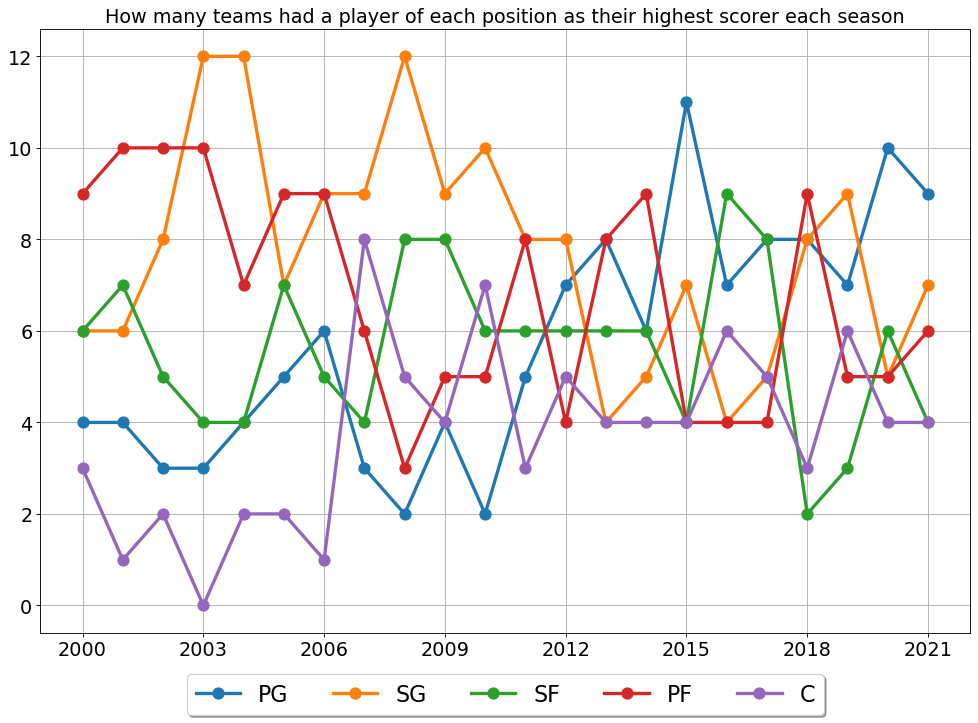

In [37]:
plt.figure(figsize=(15, 10), dpi=80)
for position in POSITIONS:
    plt.plot(SEASONS, position_with_more_scoring[position], label=position, lw=3, marker='o', ms=10)

plt.grid()
plt.title("How many teams had a player of each position as their highest scorer each season")
plt.xticks([2000,2003,2006,2009,2012,2015,2018,2021])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5, prop={'size': 20})
plt.savefig("Results/PositionsEvolution/Positions_with_most_scoring.png")
plt.show()

# Analyzing the impact of positions by average stats

In [38]:
pd.set_option('display.max_rows', None)
df = pd.DataFrame(player_dfs[17].groupby(by=['Pos']).mean())
df.sort_values(by=['PTS', 'MP'], ascending=[False, False], inplace=True)
df[['MP', 'PTS', 'AST']]

,MP,PTS,AST
Pos,,,
PG,19.972650,8.794017,3.436752
SF,21.254545,8.554545,1.474545
SG,20.346774,8.489516,1.681452
C,18.228947,7.869298,1.171930
PF,18.095349,7.331783,1.055814
PF-C,14.000000,5.400000,1.000000


In [39]:
avg_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
#     df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
#     df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).mean())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    avg_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/AverageStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

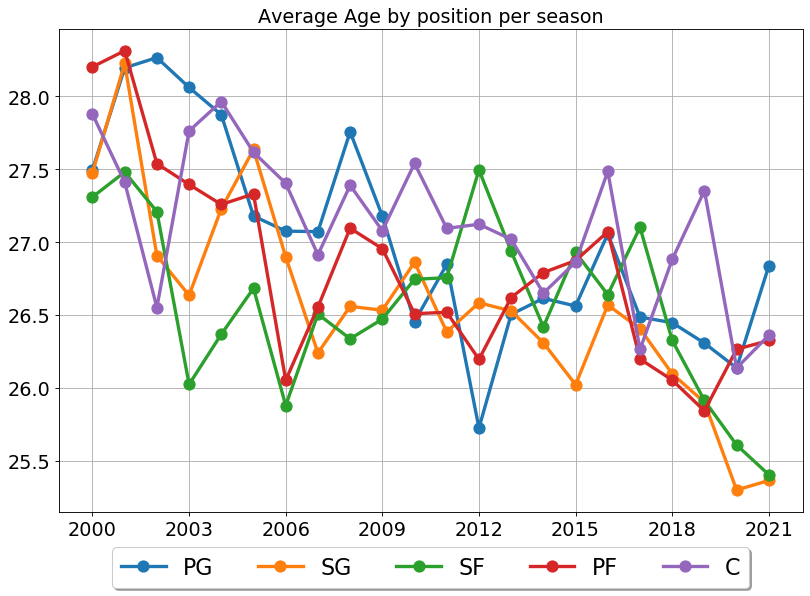

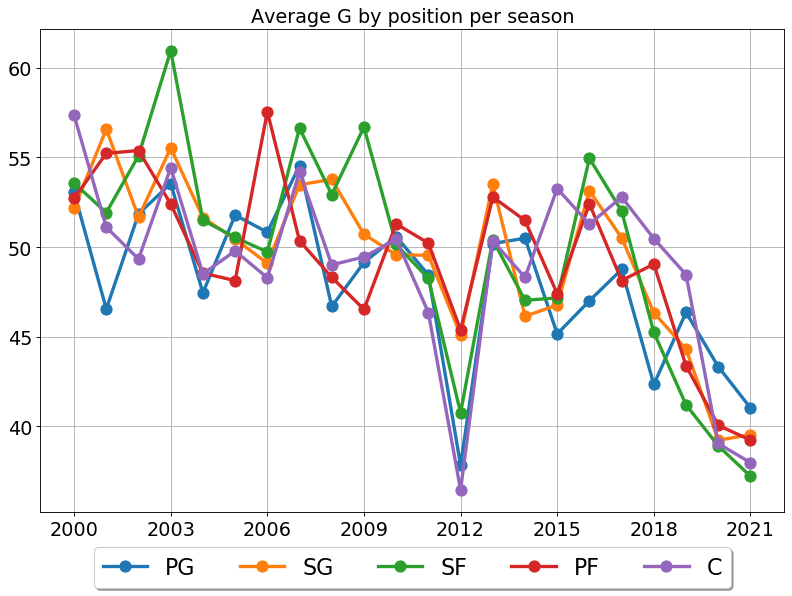

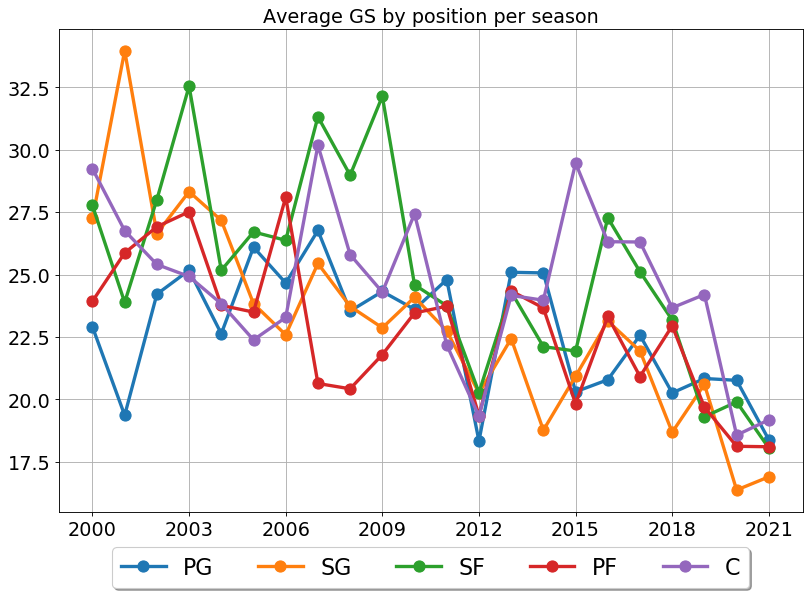

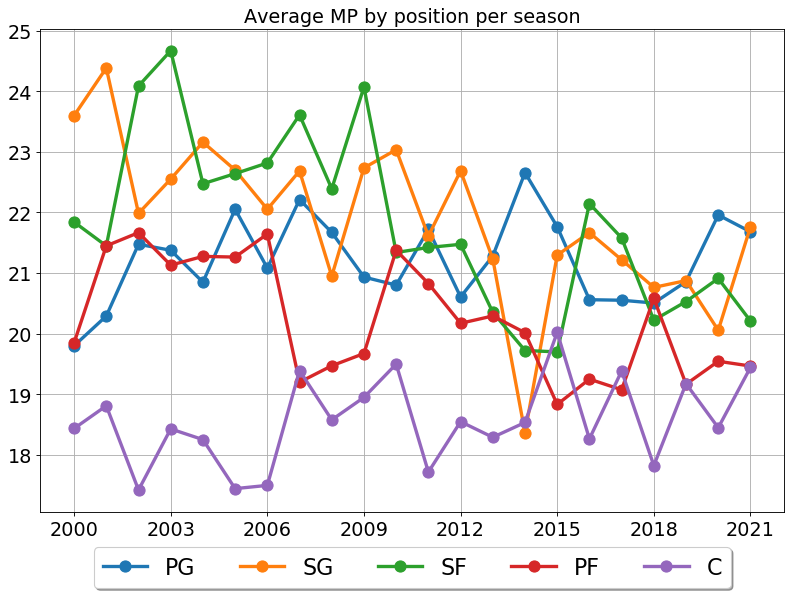

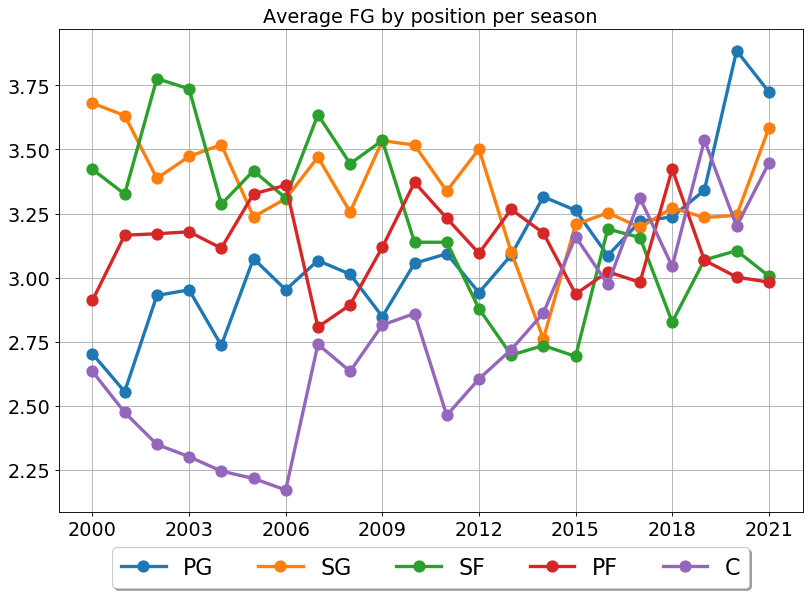

...

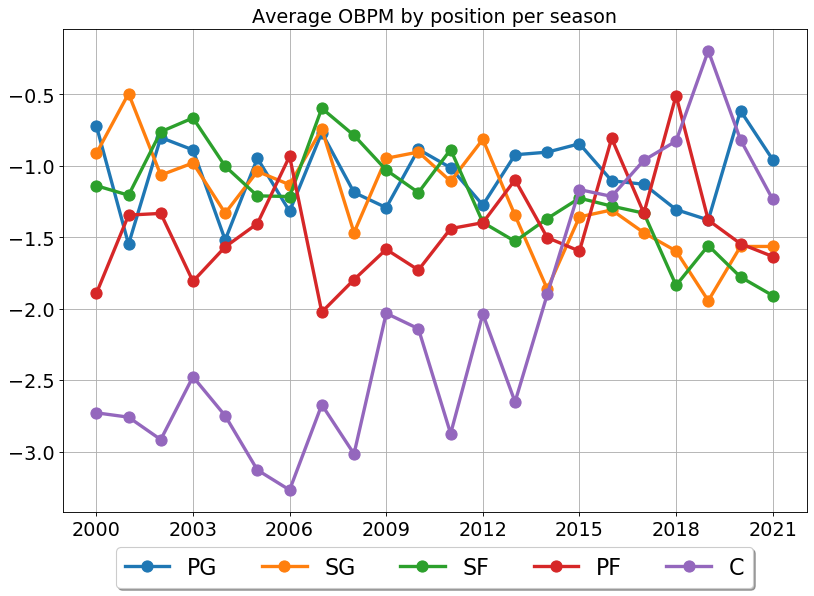

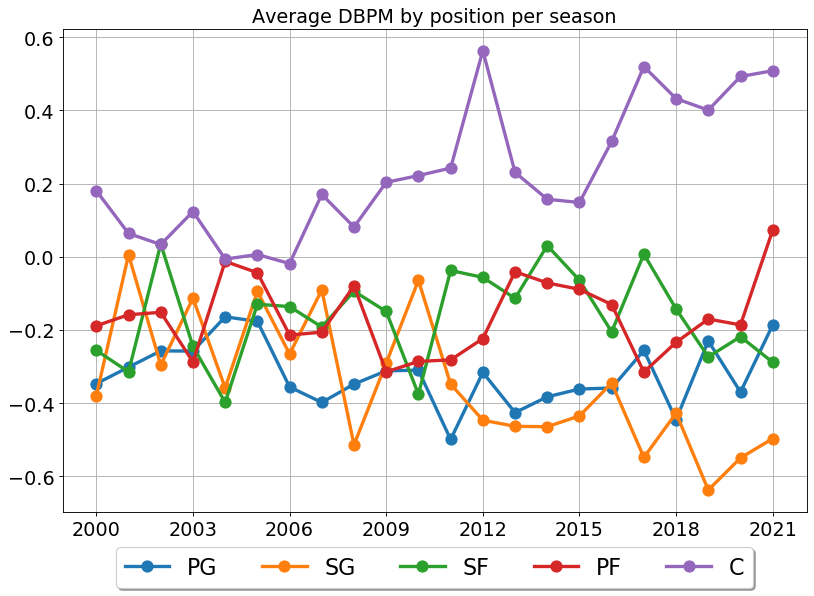

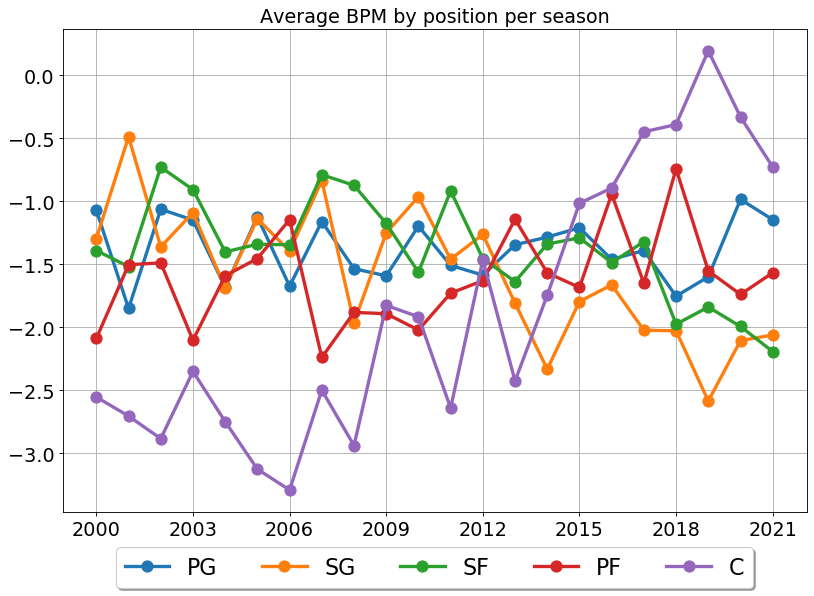

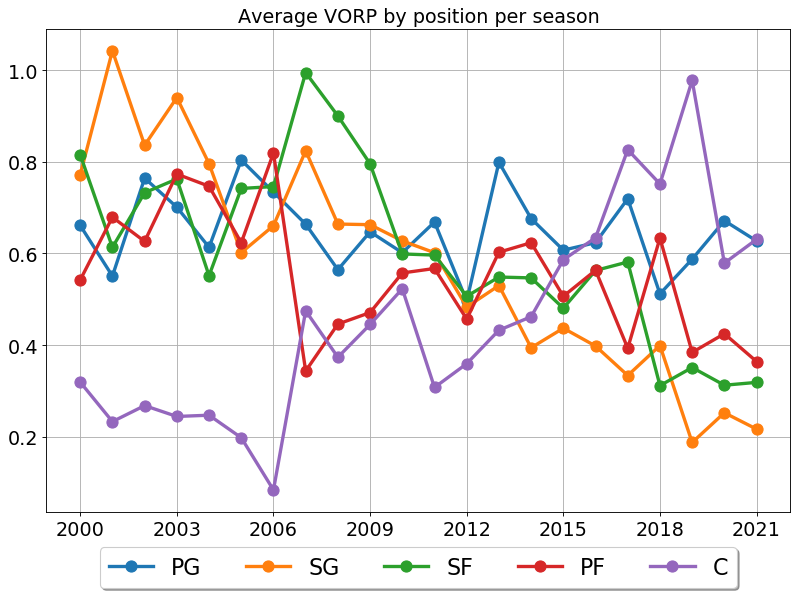

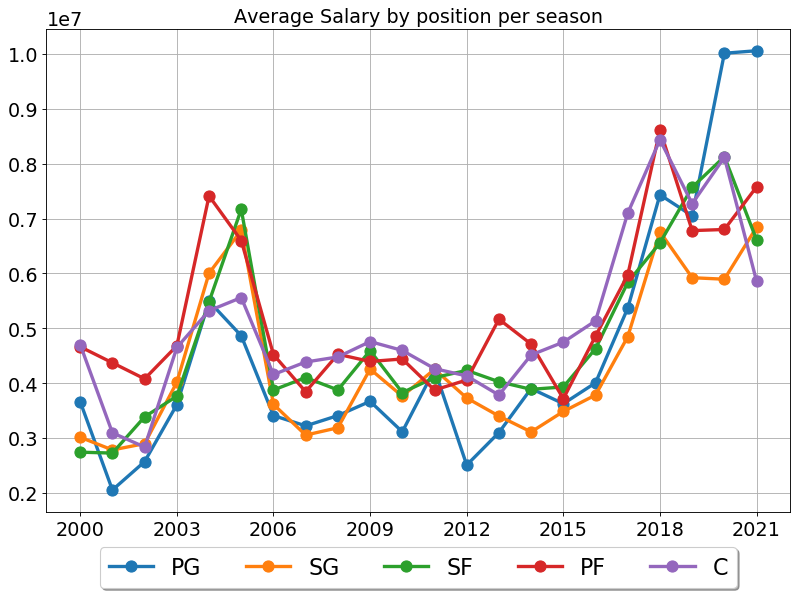

In [40]:
stats = avg_by_pos[0].columns
for stat in stats:
    avg_by_pos_each_season = get_avg_by_position_each_season(stat)
    plot_position_graph(avg_by_pos_each_season, stat)

In [41]:
avg_by_pos

[             Age          G         GS         MP        FG       FGA  \
 Pos                                                                     
 SG     27.475610  52.158537  27.243902  23.600000  3.680488  8.798780   
 SF-SG  25.000000  57.000000   2.000000  20.500000  3.400000  8.700000   
 SF     27.309278  53.567010  27.762887  21.842268  3.422680  7.813402   
 PF     28.201923  52.711538  23.932692  19.846154  2.911538  6.272115   
 PG     27.495146  53.058252  22.902913  19.798058  2.702913  6.428155   
 C      27.878049  57.353659  29.231707  18.431707  2.634146  5.559756   
 PF-SF  30.000000  62.000000  11.000000  21.000000  2.400000  5.800000   
 SF-PF  27.000000  28.000000   0.000000  11.000000  1.000000  2.400000   
 
             FG%        3P       3PA       3P%  ...       USG%       OWS  \
 Pos                                            ...                        
 SG     0.407366  0.759756  2.214634  0.294976  ...  20.089024  1.539024   
 SF-SG  0.395000  0.600000  1.

In [42]:
sd_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).std())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    sd_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/StandardDeviationStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

# Analyzing highest scorers by position in the playoffs

In [43]:
df = pd.DataFrame(playoff_player_dfs[18].groupby(by=['Tm','Pos'])['PTS'].max())
df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
df

PTS
Tm  Pos      
BOS SF   18.5
    SG   18.0
    PG   16.5
    C    15.7
    PF   12.4
CLE PF   34.0
    C    14.9
    PG    9.2
    SG    8.7
    SF    1.0
GSW SF   29.0
    PG   25.5
    SG   19.6
    PF   10.8
    C     6.5
HOU SG   28.6
    PG   21.1
    C    12.7
    PF    8.9
    SF    8.8
IND SG   22.7
    C    12.4
    SF   12.4
    PF   11.3
    PG   11.3
MIA PG   18.6
    SG   16.6
    PF   12.8
    SF    8.4
    C     5.2
MIL PF   25.7
    SF   24.7
    PG   13.6
    C     9.5
    SG    6.3
MIN SF   15.8
    SG   15.8
    C    15.2
    PG   14.2
    PF    6.2
NOP PF   30.1
    SG   23.7
    PG   10.3
    SF    4.8
    C     0.0
OKC PG   29.3
    SF   24.7
    PF   11.8
    C    10.5
    SG    6.2
PHI C    21.4
    SG   18.2
    PF   17.2
    PG   16.3
    SF    8.1
POR SG   25.3
    PG   18.5
    PF   17.3
    C    11.8
    SF    9.3
SAS C    23.6
    PG   13.4
    PF   12.2
    SG    9.0
    SF    5.4
TOR SG   22.7
    PG   17.4
    C    14.6
    SF    9.6
    PF    8.7
UTA SG   24.4
    SF   14.5
    PG   14.0
    C    13.2
    PF    1.9
WAS PG   26.0
    SG   23.2
    PF   10.8
    SF   10.0
    C     8.7

In [44]:
highest_scorer_by_pos_and_season = {}
for team in TEAMS:
    highest_scorer_by_pos_and_season[team] = {}
    
for i in range(len(SEASONS)):
    df = pd.DataFrame(playoff_player_dfs[i])
    df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
    for team in TEAMS:
        players_from_team = df[df['Tm'] == team]
        if not players_from_team.empty:
            highest_scorer_from_team = players_from_team.iloc[0][['Pos', 'PTS']]
            highest_scorer_by_pos_and_season[team][SEASONS[i]] = list(highest_scorer_from_team)
        
highest_scorer_by_pos_and_season

{'ATL': {2008: ['SG', 20.0],
  2009: ['PF', 17.1],
  2010: ['SG', 17.9],
  2011: ['SG', 18.8],
  2012: ['SG', 17.2],
  2013: ['PF', 17.0],
  2014: ['PF', 19.4],
  2015: ['PG', 16.8],
  2016: ['PF', 16.7],
  2017: ['PG', 24.7],
  2021: ['PG', 28.8]},
 'BOS': {2002: ['SG', 24.6],
  2003: ['SG', 27.1],
  2004: ['SG', 20.8],
  2005: ['SF', 22.9],
  2008: ['PF', 20.4],
  2009: ['SF', 21.0],
  2010: ['SF', 18.8],
  2011: ['SF', 20.8],
  2012: ['C', 19.2],
  2013: ['PF', 20.3],
  2015: ['PG', 17.5],
  2016: ['PG', 24.2],
  2017: ['PG', 23.3],
  2018: ['SF', 18.5],
  2019: ['PG', 21.3],
  2020: ['PF', 25.7],
  2021: ['SF', 30.6]},
 'BRK': {2002: ['PG', 19.6],
  2003: ['PG', 20.1],
  2004: ['SF', 19.8],
  2005: ['SF', 26.8],
  2006: ['SG', 29.6],
  2007: ['SG', 22.3],
  2013: ['C', 22.3],
  2014: ['SG', 21.2],
  2015: ['C', 19.8],
  2019: ['SF', 21.0],
  2020: ['SG', 20.3],
  2021: ['PF', 34.3]},
 'CHI': {2005: ['PG', 21.2],
  2006: ['PF', 22.3],
  2007: ['SF', 22.2],
  2009: ['SG', 24.3],
  20

In [45]:
position_with_more_scoring = {}

for position in POSITIONS:
    position_with_more_scoring[position] = np.zeros(len(SEASONS), dtype=int)
    
for i in range(len(SEASONS)):
    season = SEASONS[i]
    for team in TEAMS:
#         print(team)
        if season in highest_scorer_by_pos_and_season[team]:
            position = highest_scorer_by_pos_and_season[team][season][0]
            if position in POSITIONS:        
                position_with_more_scoring[position][i] += 1
        
position_with_more_scoring

{'PG': array([2, 1, 3, 3, 5, 3, 1, 1, 4, 2, 4, 3, 4, 4, 3, 3, 5, 8, 3, 3, 5, 8]),
 'SG': array([5, 6, 4, 6, 5, 3, 6, 5, 5, 4, 5, 4, 2, 2, 5, 5, 3, 1, 6, 3, 4, 2]),
 'SF': array([2, 2, 1, 1, 1, 6, 2, 4, 2, 4, 4, 4, 5, 2, 2, 3, 5, 6, 2, 5, 2, 2]),
 'PF': array([4, 6, 6, 6, 4, 3, 7, 2, 3, 4, 3, 4, 3, 6, 6, 3, 3, 1, 3, 3, 3, 2]),
 'C': array([3, 1, 2, 0, 1, 1, 0, 4, 2, 2, 0, 1, 2, 2, 0, 2, 0, 0, 2, 2, 2, 2])}

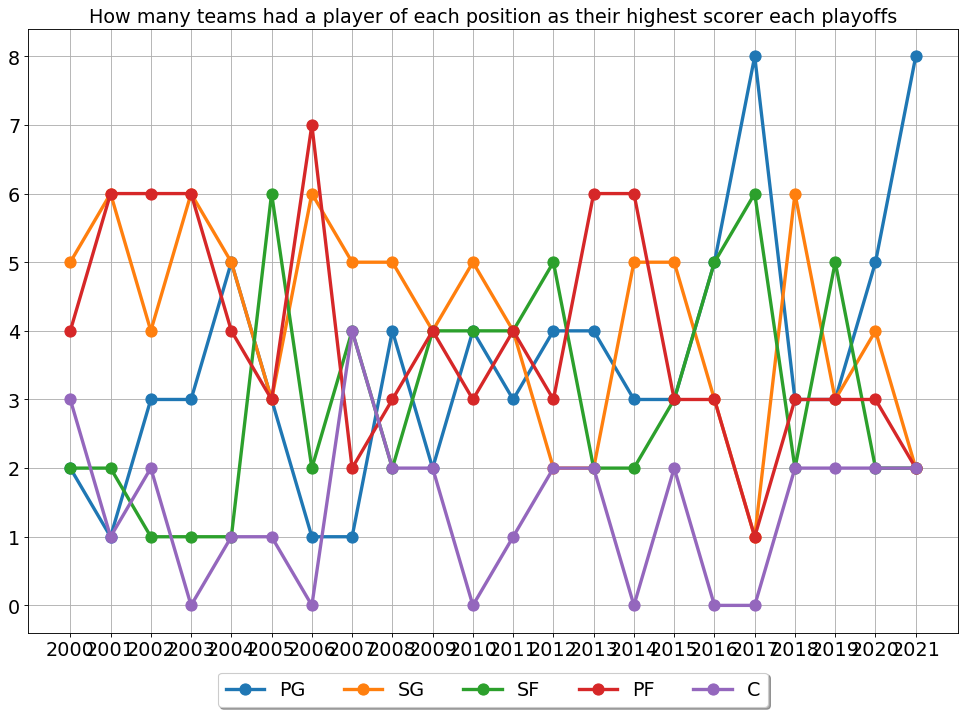

In [46]:
plt.figure(figsize=(15, 10), dpi=80)
plt.grid()
for position in POSITIONS:
    plt.plot(SEASONS, position_with_more_scoring[position], label=position, lw=3, marker='o', ms=10)
    
    
plt.title("How many teams had a player of each position as their highest scorer each playoffs")
plt.xticks(SEASONS)
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5)
plt.savefig("Results/PositionsEvolution_Playoffs/Positions_with_most_scoring_in_the_playoffs.png")
plt.show()

# Analyzing the impact of positions by average stats

In [47]:
pd.set_option('display.max_rows', None)
df = pd.DataFrame(playoff_player_dfs[17].groupby(by=['Pos']).mean())
df.sort_values(by=['PTS', 'MP'], ascending=[False, False], inplace=True)
df[['MP', 'PTS', 'AST']]

,MP,PTS,AST
Pos,,,
PG,20.197674,10.951163,3.344186
SF,22.448837,9.181395,1.797674
SG,21.829545,8.602273,1.456818
PF,17.037778,6.917778,1.020000
C,16.872500,6.452500,1.070000


In [48]:
avg_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).mean())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    avg_by_pos.append(df)
    df.to_csv("DataCollection/Positions_Playoffs/AverageStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

In [49]:
sd_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).std())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    sd_by_pos.append(df)
    df.to_csv("DataCollection/Positions_Playoffs/StandardDeviationStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

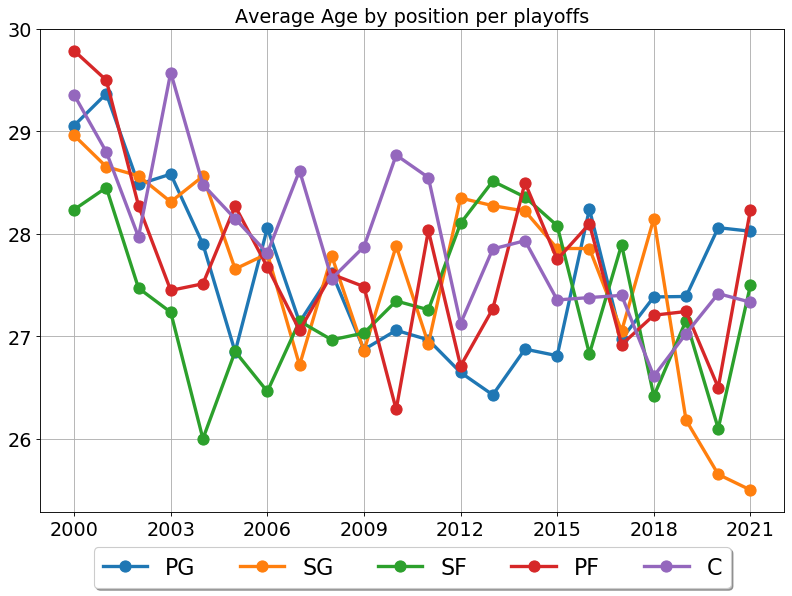

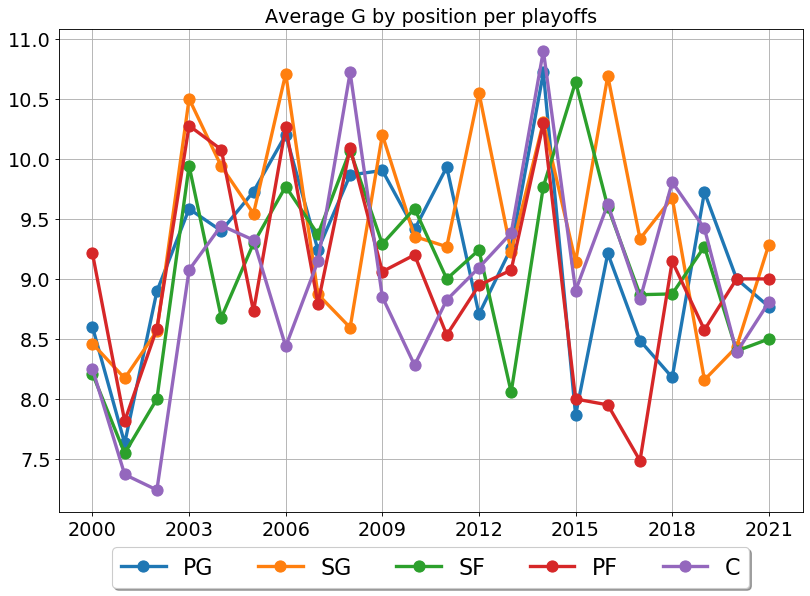

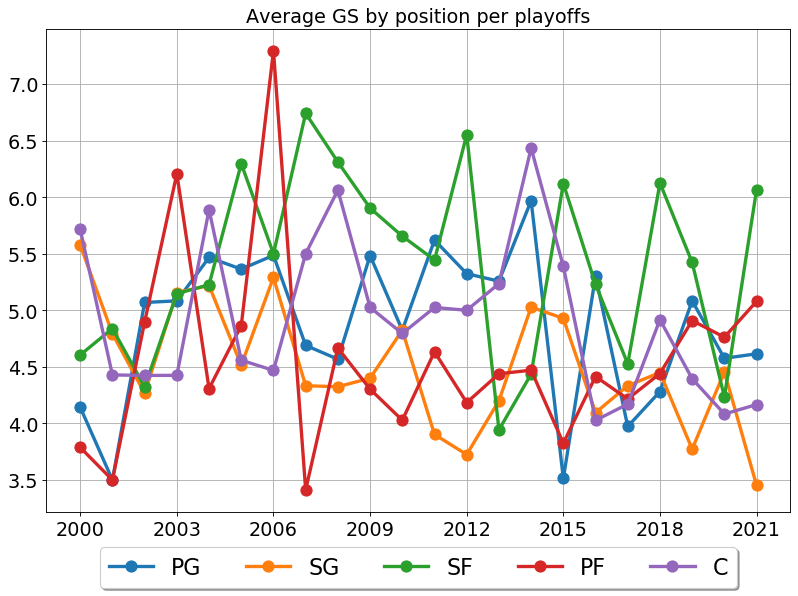

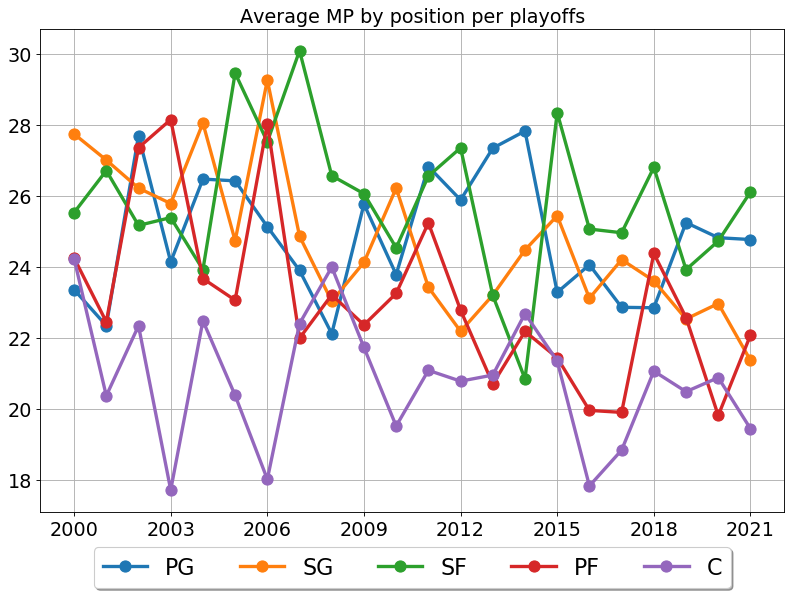

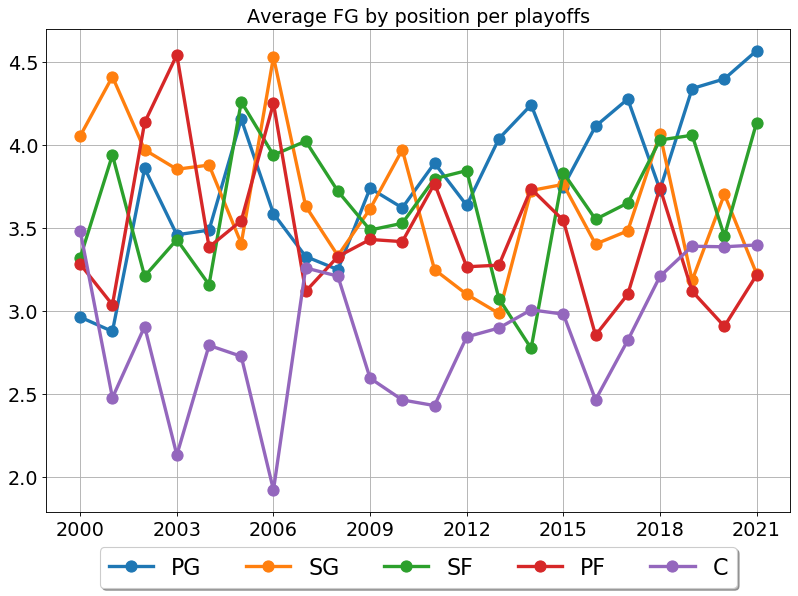

...

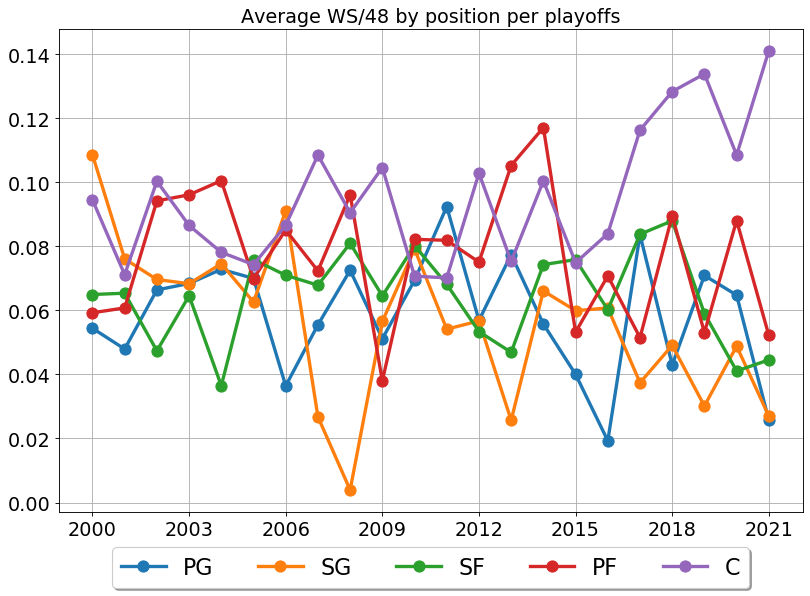

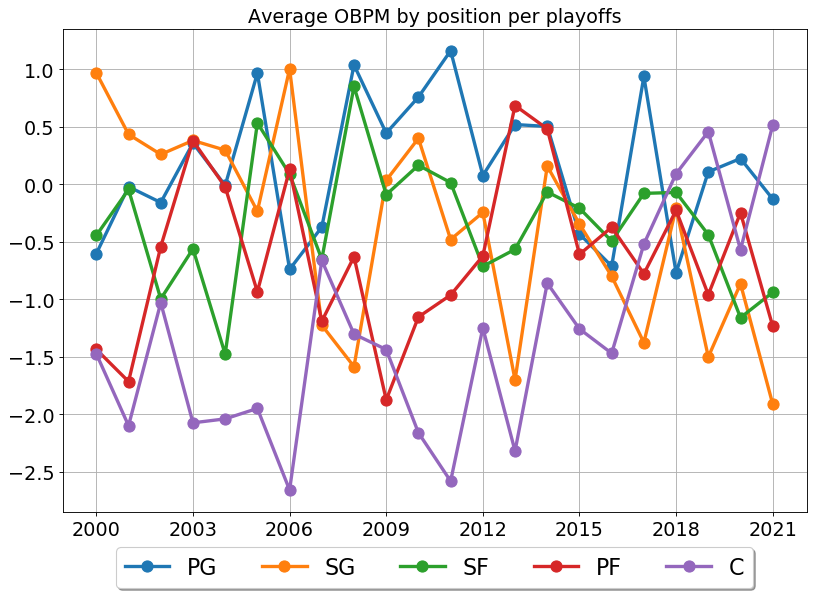

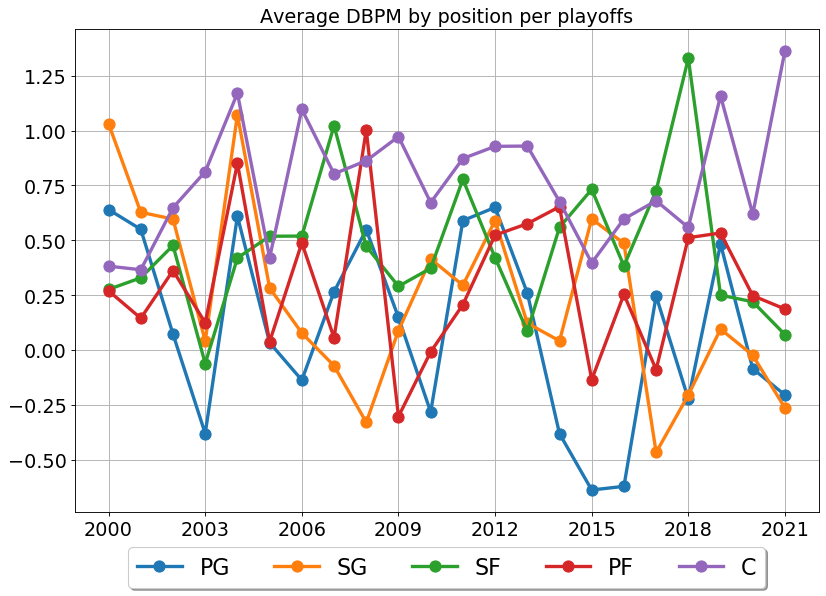

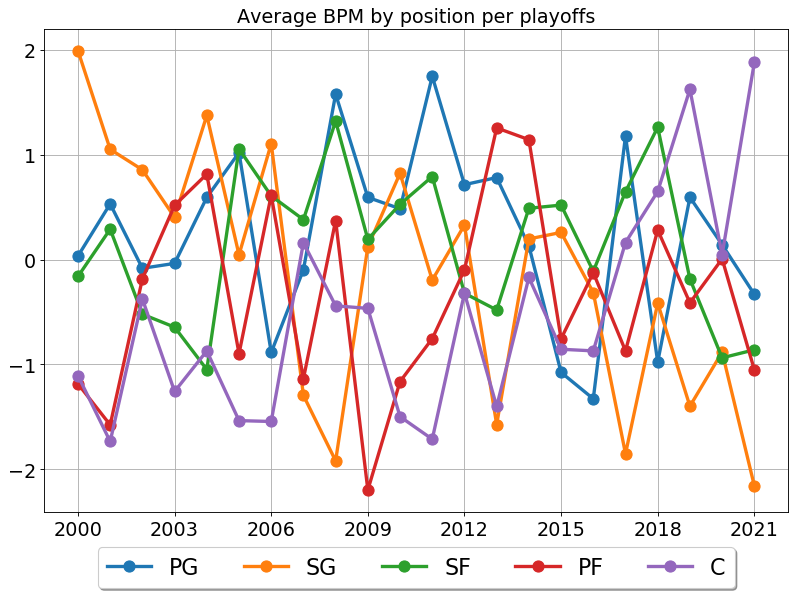

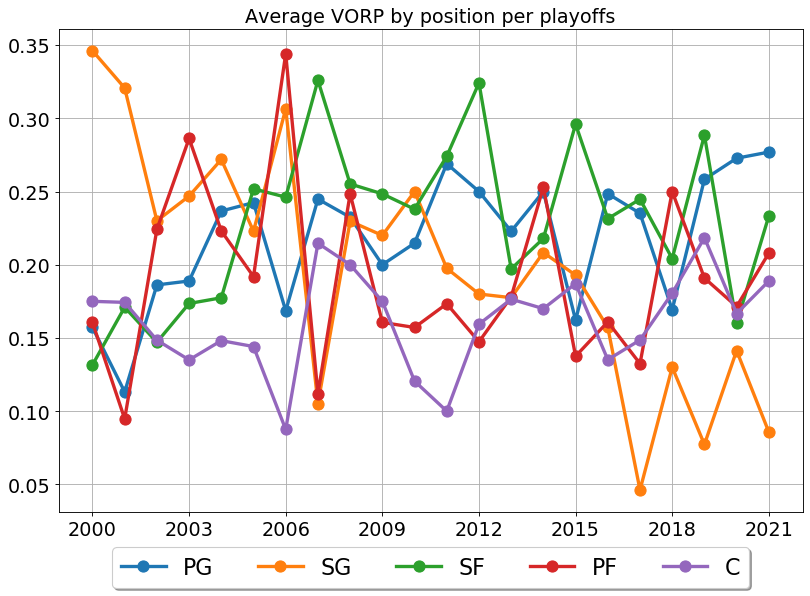

In [50]:
stats = avg_by_pos[0].columns
for stat in stats:
    avg_by_pos_each_season = get_avg_by_position_each_season(stat)
    plot_position_graph(avg_by_pos_each_season, stat, True)

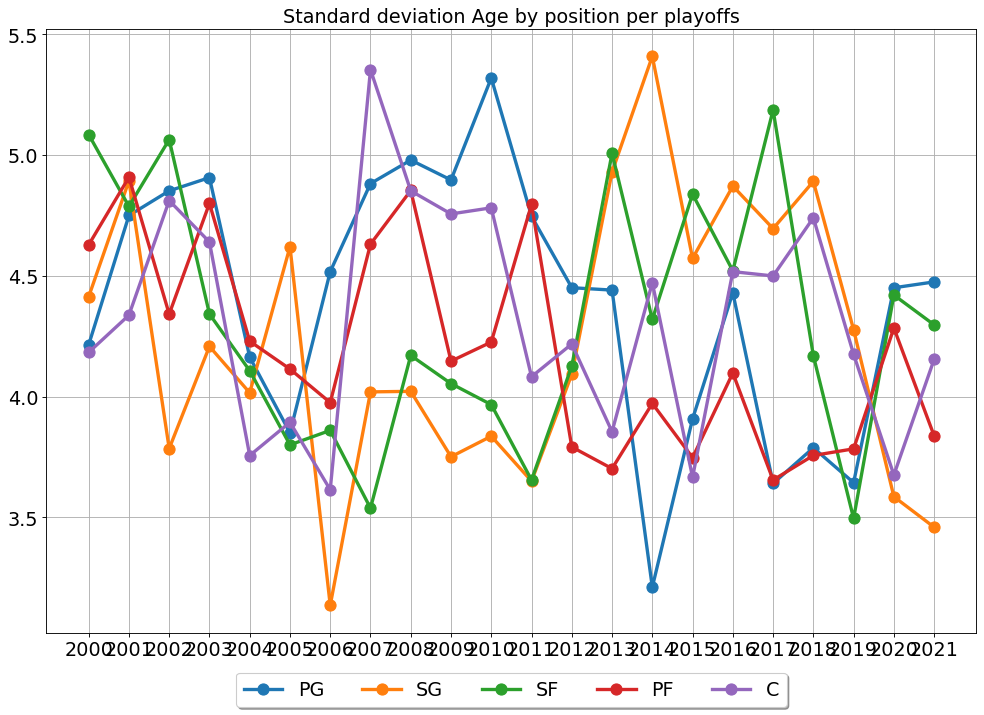

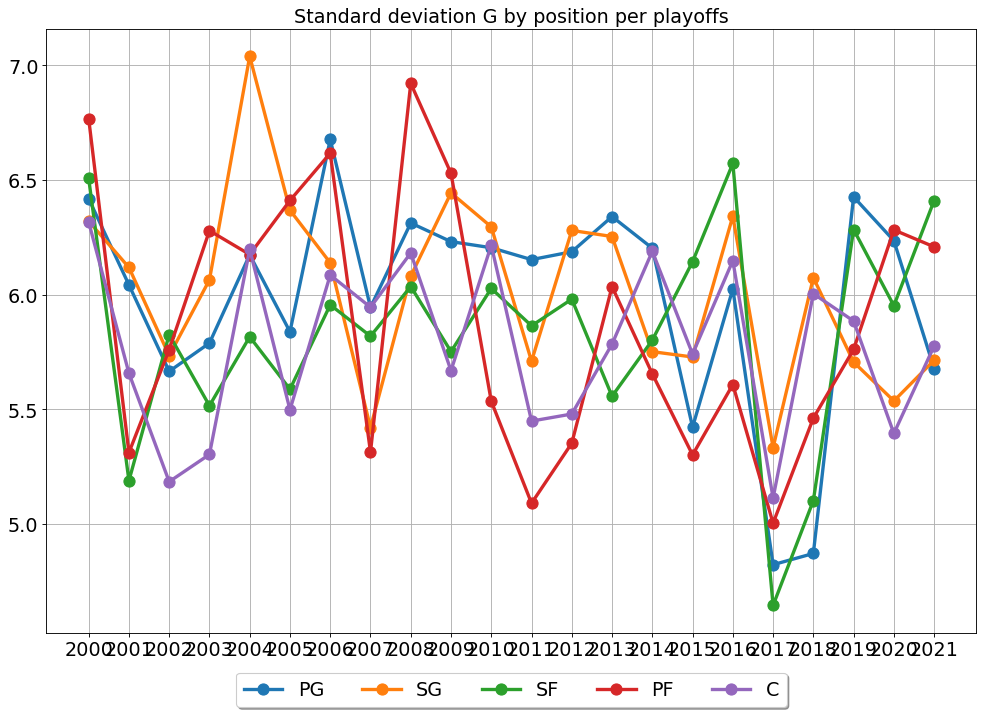

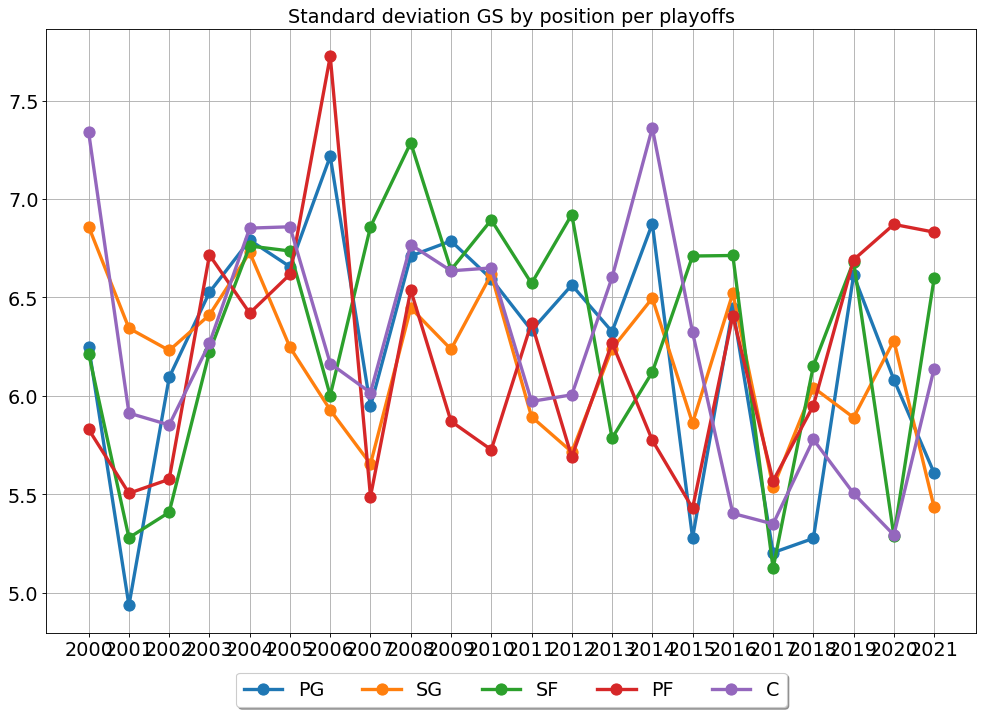

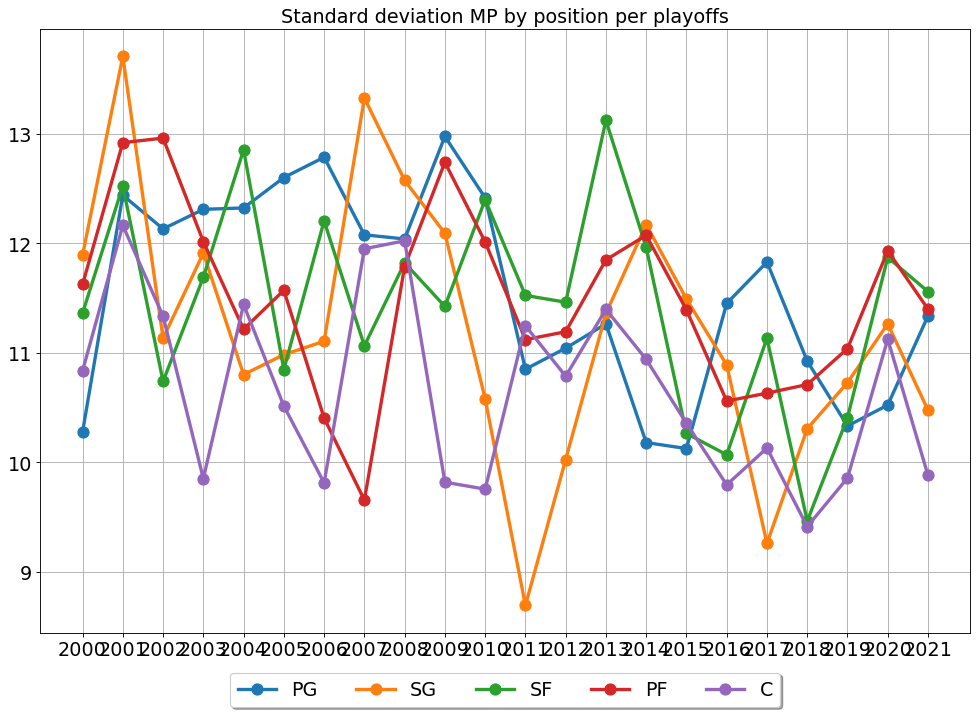

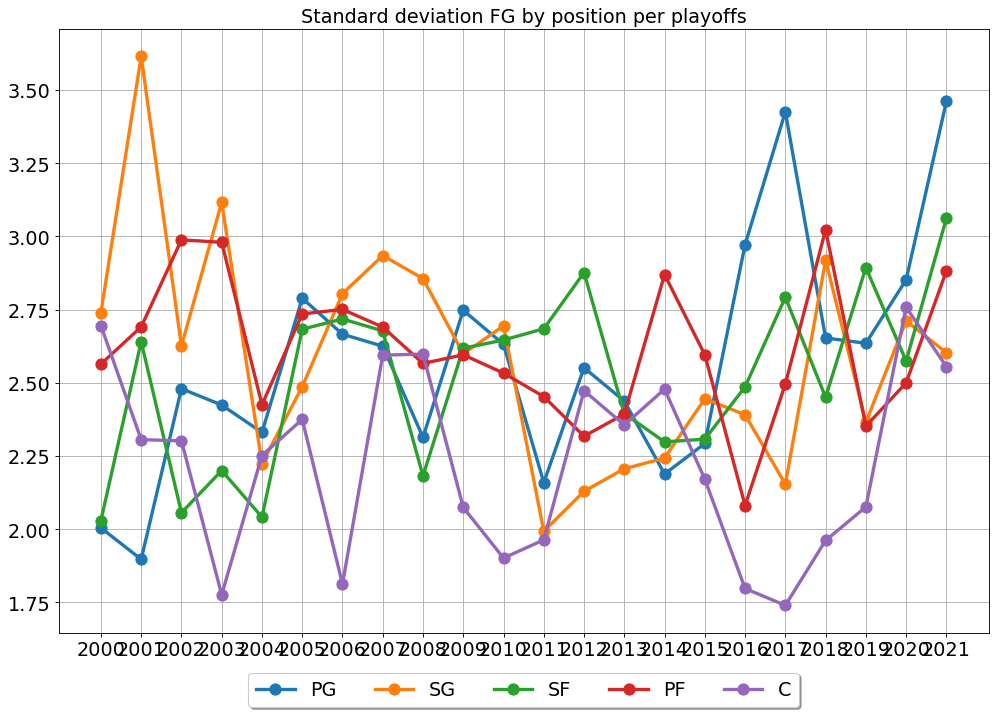

...

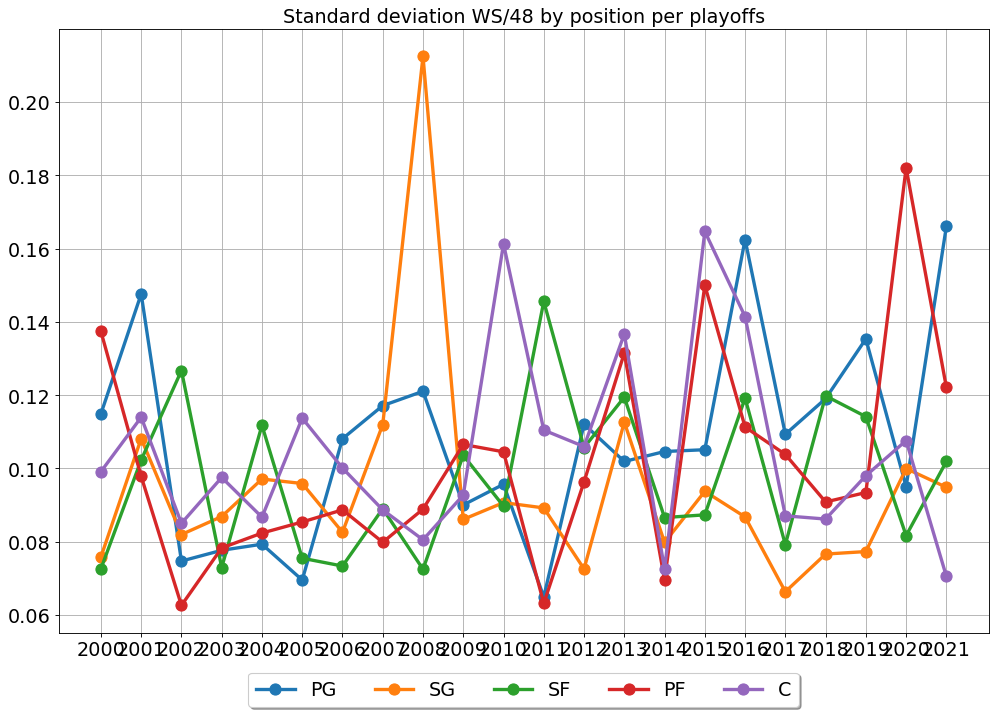

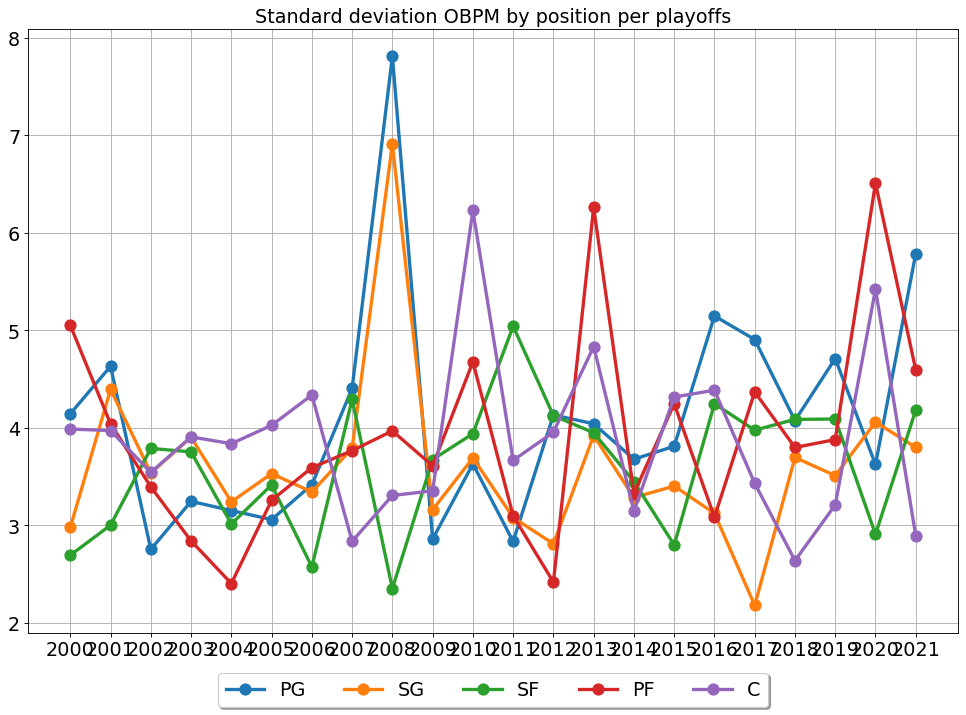

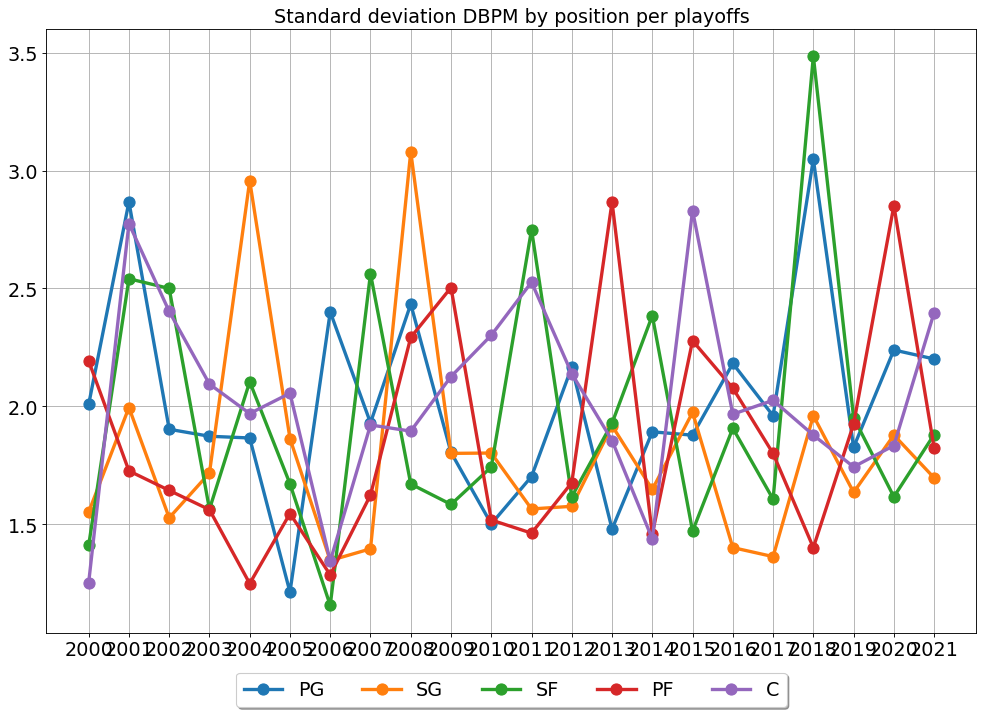

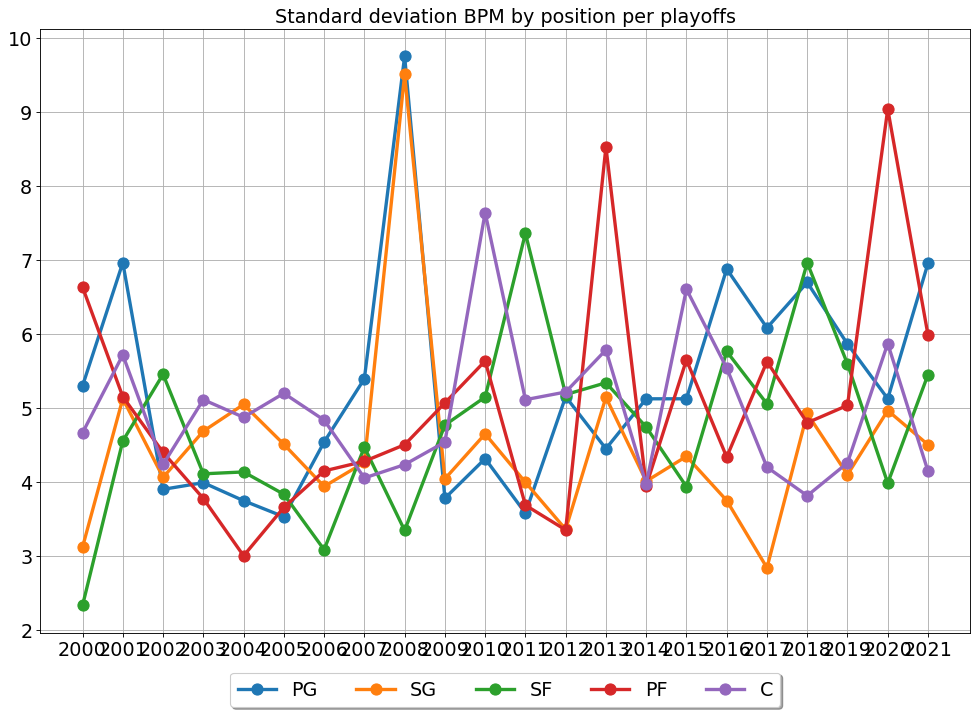

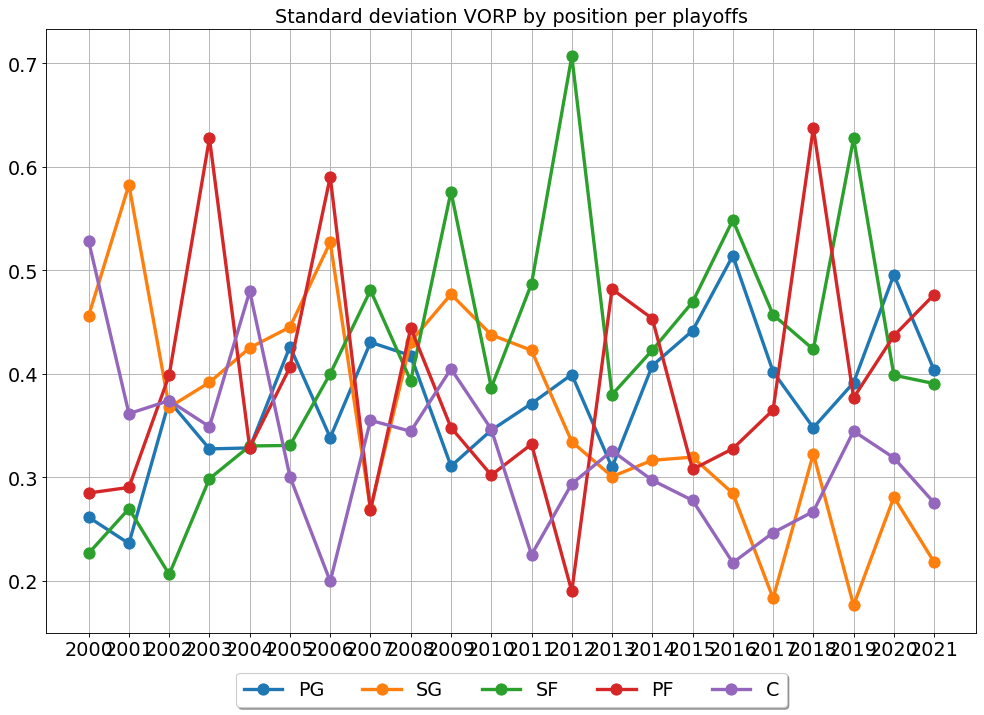

In [51]:
stats = avg_by_pos[0].columns
for stat in stats:
    sd_by_pos_each_season = get_sd_by_position_each_season(stat)
    plot_sd_position_graph(sd_by_pos_each_season, stat, True)